# Project of Computational Imaging
## By Dylan Rachwal and Tianfeng Lyu

The goal of this prokject is to adapt and benchmark the implementation of the paper [On learning optimized reaction diffusion processes for effective image restoration ](http://openaccess.thecvf.com/content_cvpr_2015/papers/Chen_On_Learning_Optimized_2015_CVPR_paper.pdf) made in python by Jean Plumail ([link](https://github.com/jplumail/learning-image-restoration) )
In this project we decided to provide and compare this algorithm with more noise type such as Poisson noise that can occur electronics or impulse noise such as salt and pepper noise.

### Optional Mount drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/Colab Notebooks/compimg/

Mounted at /content/drive
/content/drive/MyDrive/Colab Notebooks/compimg


##Introduction
Here we define the class to import the Berkeley dataset that was use in the paper and useful functions for plotting and displaying images 

In [ ]:
import os
import numpy as np
from PIL import Image
from copy import deepcopy
import torch
import torch.utils.data as data
import torchvision.transforms as transforms
from torchvision.datasets.utils import download_and_extract_archive
from torchvision.datasets.vision import VisionDataset
import matplotlib.pyplot as plt
from skimage.util import random_noise

class BSDS300_images(VisionDataset):
    basedir = "BSDS300"
    train_file = "iids_train.txt"
    test_file = "iids_test.txt"
    url = "https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/bsds/BSDS300-images.tgz"
    archive_filename = "BSDS300-images.tgz"

    def __init__(self, root,noise_type, train=True, transform=None, download=False, parameter={'sigma':25,
                'threshold':0.05,'lowerValue':5, 'upperValue':250,
                'amount':0.05,'salt_vs_pepper':0.5}):
        super(BSDS300_images, self).__init__(root, transform=transform)
        args = {'sigma':25,
                'threshold':0.05,'lowerValue':5, 'upperValue':250,
                'amount':0.05,'salt_vs_pepper':0.5}

        diff = set(parameter.keys()) - set(args.keys())
        if diff:
           print("Invalid args:",tuple(diff))
           return

        args.update(parameter)  
        self.train = train
        
        #noise_type
        self.noise_type = noise_type
        #parameter for gaussian noise
        self.sigma = args['sigma']/255
        
        #parameter for Salt and Pepper noise 
        self.threshold = args['threshold']
        self.lowerValue = args['lowerValue'] / 255 # 255 would be too high
        self.upperValue = args['upperValue'] / 255 # 0 would be too low

        #parameter for Salt and Pepper noise
        self.amount = args['amount']
        self.salt_vs_pepper = args['salt_vs_pepper']
        
        self.root = root
        images_basefolder = os.path.join(root, self.basedir, "images")
        subfolder = "train" if self.train else "test"
        self.image_folder = os.path.join(images_basefolder, subfolder)
        id_file = self.train_file if self.train else self.test_file
        self.id_path = os.path.join(root, self.basedir, id_file)

        if download:
            self.download()

        if not self._check_exists():
            raise RuntimeError('Dataset not found.' +
                               ' You can use download=True to download it')
        
        self.ids = np.loadtxt(self.id_path).astype('int')
        self.transform = transform
    
    def _check_exists(self):
        return os.path.exists(self.id_path) and os.path.exists(self.image_folder)
    
    def download(self):
        if self._check_exists():
            print("Files already downloaded")
            return
        download_and_extract_archive(self.url, download_root=self.root, filename=self.archive_filename)

    
    def __len__(self):
        return len(self.ids)
    
    def __getitem__(self, idx):
        img_name = os.path.join(self.image_folder, str(self.ids[idx])) + ".jpg"
        im = Image.open(img_name)
        if self.transform:
            im = self.transform(im)
        if self.noise_type == 'Gaussian':
            im_noisy = im + torch.randn(im.size()) * self.sigma
        elif self.noise_type =='SnP':
            random_matrix = torch.randn(im.size())  
            im_noisy=deepcopy(im)
            im_noisy[random_matrix>=(1-self.threshold)] = self.upperValue
            im_noisy[random_matrix<=self.threshold] = self.lowerValue

        elif self.noise_type =='s&p':
            im_noisy = random_noise(im, self.noise_type, amount=self.amount, salt_vs_pepper=self.salt_vs_pepper)
        elif self.noise_type =='speckle':
            im_noisy = random_noise(im, self.noise_type, var=self.sigma)
            im_noisy=im_noisy.astype('float32')
        elif self.noise_type == 'poisson':
            im_noisy = random_noise(im, self.noise_type)
            im_noisy=im_noisy.astype('float32')

        return im_noisy, im


class BerkeleyLoader(data.DataLoader):
    def __init__(self,noise_type, train=True,parameter={'sigma':25,'threshold':0.05,'lowerValue':5, 'upperValue':250,'amount':0.05,'salt_vs_pepper':0.5}, **kwargs):
        if train:
            transform = transforms.Compose([
                transforms.RandomCrop(90, pad_if_needed=True, padding_mode="reflect"),
                transforms.ToTensor()
            ])
        else:
            transform = transforms.ToTensor()
        dataset = BSDS300_images("data",noise_type, train=train, transform=transform, download=True, parameter=parameter)
        super(BerkeleyLoader, self).__init__(dataset, **kwargs)


In [ ]:
def convert_to_numpy(image):
  image_=np.zeros((image[0].shape[0],image[0].shape[1],3))
  image_[:,:,0]=image[0]
  image_[:,:,1]=image[1]
  image_[:,:,2]=image[2]
  image_ = image_/np.amax(image_)
  image_ = np.clip(image_, 0, 1)
  return image_

## Creation of the Neural network

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F



class DiffusionNetStep(nn.Module):
    def __init__(self, rbf, n_channels=3, n_filters=5, filter_size=5):
        super(DiffusionNetStep, self).__init__()
        self.padding = filter_size // 2 + (filter_size - 2 * (filter_size // 2)) - 1
        self.conv = nn.Conv2d(n_channels, n_filters, filter_size, padding=self.padding, bias=False, padding_mode="replicate")
        self.means = rbf["means"]
        self.std = rbf["std"]
        n_rbf = self.means.shape[0]
        self.weights_rbf = nn.Parameter(torch.ones(n_filters, n_rbf) / n_rbf)
        self.reaction_weight = nn.Parameter(torch.ones(1, dtype=torch.float32))
    def compute_nonlinearity(self, u):
        s = torch.zeros(u.shape, dtype=torch.float32).to(u.device)
        for i in range(len(self.means)):
            v = (u - self.means[i]) / self.std[i]
            v = torch.exp(-torch.pow(v, 2))
            v = self.weights_rbf[None,:,i,None,None] * v
            s += v
        return s
    
    def compute_diffusion(self, u):
        # First conv
        u = self.conv(u)

        # Non linearity
        u = self.compute_nonlinearity(u)

        # Rotated conv
        rotated_kernels_weights = torch.rot90(self.conv.weight, 2, [2, 3]) # rotate 2 times conv1 weights
        rotated_kernels_weights = torch.transpose(rotated_kernels_weights, dim0=0, dim1=1)
        u = nn.ReplicationPad2d(self.padding)(u)
        u = F.conv2d(u, rotated_kernels_weights)
        return u
    
    def forward(self, u, f):
        u = u - (self.compute_diffusion(u) + self.reaction_weight *(u - f))
        #u = u - (self.compute_diffusion(u) + self.reaction_weight * torch.transpose(self.A)@(self.A @ u - f))
        return u


class DiffusionNet(nn.Module):
    def __init__(self, n_rbf=63, T=5, **dnet_args):
        super(DiffusionNet, self).__init__()
        means = nn.Parameter(torch.randn(n_rbf, dtype=torch.float32))
        std = nn.Parameter(torch.randn(n_rbf, dtype=torch.float32) + 1.0)
        rbfs = {"means": means, "std": std}
        self.dnets = nn.ModuleList([DiffusionNetStep(rbfs, **dnet_args) for i in range(T)])
    
    def step(self, u, f, i):
        return self.dnets[i].forward(u, f)
    
    def forward(self, u, f):
        for i in range(len(self.dnets)):
            u = self.step(u, f, i)
        return u

## Training
Here we will train multiple neural networks on different noise type.

The configuration are :

*   Filter size = $5 \times 5$  / Filter size = $7 \times 7$
*   Number of filters = 24  / Number of filters = 48
*   Joint / Greedy training
*   Noise Type (Gaussian, Salt and pepper (skimage or ours), Speckle, Poisson)


In [ ]:
import os
import argparse
import torch
import torch.nn as nn
import torch.optim as optim
import torch.autograd.profiler as profiler
from tqdm import tqdm
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import mean_squared_error as mse

def calc_psnr(im_true, im_noisy):
    im_true = im_true.detach().cpu().numpy()
    im_noisy = im_noisy.detach().cpu().numpy()
    return psnr(im_true, im_noisy)

def training(model, criterion, optimizer, scheduler, epochs, train_loader, test_loader, mode,path):
    best_psnr = 0
    not_improvement_counter = 0
    for e in range(epochs):
        print("Epoch", e)

        # Training the model
        print("Training")
        model.train()
        loss_train = 0
        for im_noisy, im in tqdm(train_loader):
            im_noisy, im = im_noisy.cuda(), im.cuda()
            im_pred = torch.clone(im_noisy)
            if mode == "greedy":
                for i in range(len(model.dnets)):
                    optimizer.zero_grad()
                    im_pred = model.step(im_pred, im_noisy, i)
                    loss = criterion(im_pred, im)
                    loss.backward()
                    optimizer.step()
                    im_pred = im_pred.detach()
            elif mode == "joint":
                im_pred = model(im_pred, im_noisy)
                optimizer.zero_grad()
                loss = criterion(im_pred, im)
                loss.backward()
                optimizer.step()
            loss_train += loss.item()
        print("Training loss : ", loss_train/len(train_loader))
        
        # Evaluating the model
        if e % 5 == 0 or e == epochs-1:
            print("Testing")
            model.eval()
            loss_val = 0
            metric = 0
            for im_noisy, im in tqdm(test_loader):
                im_noisy, im = im_noisy.cuda(), im.cuda()
                im_pred = torch.clone(im_noisy)
                with torch.no_grad():
                    im_pred = model(im_pred, im_noisy)
                    loss = criterion(im_pred, im)
                metric += calc_psnr(im, im_pred)
                loss_val += loss.item()
            avrg_val_loss = loss_val/len(test_loader)
            avrg_metric = metric / len(test_loader)
            print("Validation loss : ", avrg_val_loss)
            print("PSNR : ", avrg_metric)
        
            if avrg_metric > best_psnr:
                print("Best PSNR. Saving model")
                best_psnr = avrg_metric
                torch.save(model.state_dict(), path)
            scheduler.step(avrg_metric)


        ### early stop

        if e == 0:
          best_loss= loss_train/len(train_loader)
        else :
          if best_loss > loss_train/len(train_loader):
            best_loss= loss_train/len(train_loader)
            not_improvement_counter = 0
          else :
            not_improvement_counter +=1
        if not_improvement_counter >=6:
          print("Testing")
          model.eval()
          loss_val = 0
          metric = 0
          for im_noisy, im in tqdm(test_loader):
              im_noisy, im = im_noisy.cuda(), im.cuda()
              im_pred = torch.clone(im_noisy)
              with torch.no_grad():
                  im_pred = model(im_pred, im_noisy)
                  loss = criterion(im_pred, im)
              metric += calc_psnr(im, im_pred)
              loss_val += loss.item()
          avrg_val_loss = loss_val/len(test_loader)
          avrg_metric = metric / len(test_loader)
          print("Validation loss : ", avrg_val_loss)
          print("PSNR : ", avrg_metric)
      
          if avrg_metric > best_psnr:
              print("Best PSNR. Saving model")
              best_psnr = avrg_metric
              torch.save(model.state_dict(), path)
          scheduler.step(avrg_metric)
          break
    
    return None



In [ ]:
### parameter
noise_type = 'Gaussian'
parameter={'sigma':25}
steps=8
n_filters_list=[24,48]
filter_size_list=[5,7]
modes=['joint']
epochs=50
for mode in modes :
  for n_filters, filter_size in zip(n_filters_list, filter_size_list):
    pretrained = noise_type+'_greedy'+str(filter_size)+'.pth'
    model_path = noise_type+'_'+mode+str(filter_size)+'.pth'

    train_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=True, batch_size=1, shuffle=True, num_workers=2)
    test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)

    model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
    if pretrained:
        model.load_state_dict(torch.load(pretrained))
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', patience=0, factor=0.1, verbose=True)
    training(model, criterion, optimizer, scheduler, epochs, train_loader, test_loader, mode, model_path)

Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [00:46<00:00,  4.34it/s]


Training loss :  0.0011641383184178267
Testing


100%|██████████| 100/100 [00:32<00:00,  3.11it/s]


Validation loss :  0.0011111370402795728
PSNR :  29.954377501249198
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [00:44<00:00,  4.46it/s]


Training loss :  0.0010504232285529725
Epoch 2
Training


100%|██████████| 200/200 [00:44<00:00,  4.49it/s]


Training loss :  0.0011222160355100642
Epoch 3
Training


100%|██████████| 200/200 [00:44<00:00,  4.50it/s]


Training loss :  0.001074742420350958
Epoch 4
Training


100%|██████████| 200/200 [00:44<00:00,  4.47it/s]


Training loss :  0.0010053179207534413
Epoch 5
Training


100%|██████████| 200/200 [00:44<00:00,  4.47it/s]


Training loss :  0.00107329102276708
Testing


100%|██████████| 100/100 [00:30<00:00,  3.33it/s]


Validation loss :  0.00108421678916784
PSNR :  30.100098739836493
Best PSNR. Saving model
Epoch 6
Training


100%|██████████| 200/200 [00:45<00:00,  4.43it/s]


Training loss :  0.0011112765350117116
Epoch 7
Training


100%|██████████| 200/200 [00:45<00:00,  4.44it/s]


Training loss :  0.0010981823347901809
Epoch 8
Training


100%|██████████| 200/200 [00:44<00:00,  4.45it/s]


Training loss :  0.0010728271899279208
Epoch 9
Training


100%|██████████| 200/200 [00:44<00:00,  4.49it/s]


Training loss :  0.0011086109639290953
Epoch 10
Training


100%|██████████| 200/200 [00:44<00:00,  4.47it/s]


Training loss :  0.0010727884350853856
Testing


100%|██████████| 100/100 [00:30<00:00,  3.32it/s]


Validation loss :  0.001078016694955295
PSNR :  30.108844941498777
Best PSNR. Saving model
Testing


100%|██████████| 100/100 [00:30<00:00,  3.33it/s]


Validation loss :  0.0010776817840815057
PSNR :  30.111692355676965
Best PSNR. Saving model
Epoch     4: reducing learning rate of group 0 to 1.0000e-05.
Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [00:44<00:00,  4.48it/s]


Training loss :  0.0011248411367705557
Testing


100%|██████████| 100/100 [00:59<00:00,  1.69it/s]


Validation loss :  0.0011652109588612802
PSNR :  29.793856518114193
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [00:44<00:00,  4.47it/s]


Training loss :  0.0011346699826390249
Epoch 2
Training


100%|██████████| 200/200 [00:44<00:00,  4.49it/s]


Training loss :  0.001159570084855659
Epoch 3
Training


100%|██████████| 200/200 [00:44<00:00,  4.45it/s]


Training loss :  0.001112593226498575
Epoch 4
Training


100%|██████████| 200/200 [00:44<00:00,  4.49it/s]


Training loss :  0.001195230000812444
Epoch 5
Training


100%|██████████| 200/200 [00:45<00:00,  4.41it/s]


Training loss :  0.0010915727385145146
Testing


100%|██████████| 100/100 [00:59<00:00,  1.69it/s]


Validation loss :  0.0011234942050941754
PSNR :  29.925662687262438
Best PSNR. Saving model
Epoch 6
Training


100%|██████████| 200/200 [00:44<00:00,  4.45it/s]


Training loss :  0.0011678289974588552
Epoch 7
Training


100%|██████████| 200/200 [00:44<00:00,  4.45it/s]


Training loss :  0.0010786600528444978
Epoch 8
Training


100%|██████████| 200/200 [00:44<00:00,  4.46it/s]


Training loss :  0.001109708799631335
Epoch 9
Training


100%|██████████| 200/200 [00:44<00:00,  4.47it/s]


Training loss :  0.0011290338161052205
Epoch 10
Training


100%|██████████| 200/200 [00:45<00:00,  4.38it/s]


Training loss :  0.0010962200444191695
Testing


100%|██████████| 100/100 [01:00<00:00,  1.66it/s]


Validation loss :  0.0010927646920026745
PSNR :  30.052785636612697
Best PSNR. Saving model
Epoch 11
Training


100%|██████████| 200/200 [00:44<00:00,  4.47it/s]


Training loss :  0.001092136707447935
Epoch 12
Training


100%|██████████| 200/200 [00:45<00:00,  4.43it/s]


Training loss :  0.0010953117240569555
Epoch 13
Training


100%|██████████| 200/200 [00:45<00:00,  4.41it/s]


Training loss :  0.0011473909658525371
Testing


100%|██████████| 100/100 [00:59<00:00,  1.68it/s]

Validation loss :  0.0011000182323914487
PSNR :  29.99633539985839
Epoch     4: reducing learning rate of group 0 to 1.0000e-05.


In [ ]:
noise_type = 'SnP'
parameter={'threshold':0.005,'lowerValue':5, 'upperValue':250}
steps=8
n_filters_list=[24,48]
filter_size_list=[5,7]
modes=['joint']
epochs=50
for mode in modes :
  for n_filters, filter_size in zip(n_filters_list, filter_size_list):
    pretrained = noise_type+'_greedy'+str(filter_size)+'.pth'
    model_path = noise_type+'_'+mode+str(filter_size)+'.pth'

    train_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=True, batch_size=1, shuffle=True, num_workers=2)
    test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)

    model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
    if pretrained:
        model.load_state_dict(torch.load(pretrained))
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', patience=0, factor=0.1, verbose=True)
    training(model, criterion, optimizer, scheduler, epochs, train_loader, test_loader, mode, model_path)

Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.011879900505882689
Testing


100%|██████████| 100/100 [00:29<00:00,  3.40it/s]


Validation loss :  0.010229423011187464
PSNR :  20.29527645069485
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [01:13<00:00,  2.71it/s]


Training loss :  0.011846074757631869
Epoch 2
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.012232541112462058
Epoch 3
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.011541226257104426
Epoch 4
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.011786649309797212
Epoch 5
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.011126557426177897
Testing


100%|██████████| 100/100 [00:29<00:00,  3.40it/s]


Validation loss :  0.009899274460040033
PSNR :  20.470399100736117
Best PSNR. Saving model
Epoch 6
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.011538110502297059
Epoch 7
Training


100%|██████████| 200/200 [01:13<00:00,  2.71it/s]


Training loss :  0.012105416762642563
Epoch 8
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.011712371739558875
Epoch 9
Training


100%|██████████| 200/200 [01:13<00:00,  2.71it/s]


Training loss :  0.011496316086268053
Epoch 10
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.011121949116932229
Testing


100%|██████████| 100/100 [00:29<00:00,  3.42it/s]


Validation loss :  0.009619596165139228
PSNR :  20.591874318105802
Best PSNR. Saving model
Epoch 11
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.010727576859062537
Epoch 12
Training


100%|██████████| 200/200 [01:12<00:00,  2.74it/s]


Training loss :  0.011733498476096428
Epoch 13
Training


100%|██████████| 200/200 [01:13<00:00,  2.71it/s]


Training loss :  0.011213739911909215
Epoch 14
Training


100%|██████████| 200/200 [01:13<00:00,  2.71it/s]


Training loss :  0.011140031851246021
Epoch 15
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.011715948835480959
Testing


100%|██████████| 100/100 [00:29<00:00,  3.41it/s]


Validation loss :  0.009481105143204332
PSNR :  20.658035709525162
Best PSNR. Saving model
Epoch 16
Training


100%|██████████| 200/200 [01:12<00:00,  2.74it/s]


Training loss :  0.010935365299228578
Epoch 17
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.010776108441641554
Testing


100%|██████████| 100/100 [00:29<00:00,  3.41it/s]


Validation loss :  0.009602936969604342
PSNR :  20.61632127134972
Epoch     5: reducing learning rate of group 0 to 1.0000e-05.
Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.011096312776207923
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.010335493057500571
PSNR :  20.2587593596988
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.011085286610759795
Epoch 2
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.011662824653321878
Epoch 3
Training


100%|██████████| 200/200 [01:13<00:00,  2.74it/s]


Training loss :  0.010449335598386823
Epoch 4
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.010580360454041511
Epoch 5
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.010913102524937131
Testing


100%|██████████| 100/100 [00:57<00:00,  1.73it/s]


Validation loss :  0.00920008002780378
PSNR :  20.828335481346926
Best PSNR. Saving model
Epoch 6
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.010560742818051949
Epoch 7
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.010608217575354502
Epoch 8
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.010293174578109757
Epoch 9
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.010634029295179061
Epoch 10
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.010525372718693688
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.009092549120541662
PSNR :  20.873301802170495
Best PSNR. Saving model
Epoch 11
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.010393806644715368
Epoch 12
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.01044549174082931
Epoch 13
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.010994276067358442
Epoch 14
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.010439249768969603
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]

Validation loss :  0.00910261407494545
PSNR :  20.895636580408883
Best PSNR. Saving model


In [ ]:
noise_type = 's&p'
parameter={'amount':0.2}
steps=8
n_filters_list=[24,48]
filter_size_list=[5,7]
modes=['joint']
epochs=50
for mode in modes :
  for n_filters, filter_size in zip(n_filters_list, filter_size_list):
    pretrained = noise_type+'_greedy'+str(filter_size)+'.pth'
    model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
    train_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=True, batch_size=1, shuffle=True, num_workers=2)
    test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)

    model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
    if pretrained:
        model.load_state_dict(torch.load(pretrained))
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', patience=0, factor=0.1, verbose=True)
    training(model, criterion, optimizer, scheduler, epochs, train_loader, test_loader, mode, model_path)

Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0039624952711164955
Testing


100%|██████████| 100/100 [00:29<00:00,  3.39it/s]


Validation loss :  0.0038100392959313466
PSNR :  24.74619711491955
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.0038009575597243383
Epoch 2
Training


100%|██████████| 200/200 [01:13<00:00,  2.74it/s]


Training loss :  0.0038806983482209036
Epoch 3
Training


100%|██████████| 200/200 [01:12<00:00,  2.74it/s]


Training loss :  0.003903085479105357
Epoch 4
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0037104080649442038
Epoch 5
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.003803091422887519
Testing


100%|██████████| 100/100 [00:29<00:00,  3.38it/s]


Validation loss :  0.0036790978972567247
PSNR :  24.866285790693993
Best PSNR. Saving model
Epoch 6
Training


100%|██████████| 200/200 [01:13<00:00,  2.71it/s]


Training loss :  0.003821418380830437
Epoch 7
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.003880760066676885
Epoch 8
Training


100%|██████████| 200/200 [01:12<00:00,  2.74it/s]


Training loss :  0.0037301325498265213
Epoch 9
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0038051909432397224
Epoch 10
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.003772562256490346
Testing


100%|██████████| 100/100 [00:29<00:00,  3.39it/s]


Validation loss :  0.003552717629936524
PSNR :  24.996816916976794
Best PSNR. Saving model
Testing


100%|██████████| 100/100 [00:29<00:00,  3.39it/s]


Validation loss :  0.003549743188195862
PSNR :  24.99601533101913
Epoch     4: reducing learning rate of group 0 to 1.0000e-05.
Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0036617189430398866
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.003674626196734607
PSNR :  24.900340687282913
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.00367172083715559
Epoch 2
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0037235445572878236
Epoch 3
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.003768436814425513
Epoch 4
Training


100%|██████████| 200/200 [01:11<00:00,  2.80it/s]


Training loss :  0.0038923061816603876
Epoch 5
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.003743954585224856
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.003644879230414517
PSNR :  24.859921529761937
Epoch     2: reducing learning rate of group 0 to 1.0000e-05.
Epoch 6
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.0039033484729588965
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]

Validation loss :  0.0035414656164357437
PSNR :  25.068685229788702
Best PSNR. Saving model


In [ ]:
noise_type = 'speckle'
parameter={'sigma':25}
steps=8
n_filters_list=[24,48]
filter_size_list=[5,7]
modes=['joint']
epochs=50
for mode in modes :
  for n_filters, filter_size in zip(n_filters_list, filter_size_list):
    pretrained = noise_type+'_greedy'+str(filter_size)+'.pth'
    model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
    train_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=True, batch_size=1, shuffle=True, num_workers=2)
    test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)

    model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
    if pretrained:
        model.load_state_dict(torch.load(pretrained))
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', patience=0, factor=0.1, verbose=True)
    training(model, criterion, optimizer, scheduler, epochs, train_loader, test_loader, mode, model_path)

Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.002251562138044392
Testing


100%|██████████| 100/100 [00:29<00:00,  3.40it/s]


Validation loss :  0.0020293491901247763
PSNR :  27.461706883898692
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [01:11<00:00,  2.80it/s]


Training loss :  0.0020727024861844257
Epoch 2
Training


100%|██████████| 200/200 [01:11<00:00,  2.79it/s]


Training loss :  0.002030142004659865
Epoch 3
Training


100%|██████████| 200/200 [01:11<00:00,  2.79it/s]


Training loss :  0.0020893013627937764
Epoch 4
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.0020425242919736774
Epoch 5
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0021088521001365735
Testing


100%|██████████| 100/100 [00:29<00:00,  3.39it/s]


Validation loss :  0.0018764448681031353
PSNR :  27.799006714261587
Best PSNR. Saving model
Epoch 6
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.0019542224943143085
Epoch 7
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.0020646847036550754
Epoch 8
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.0019047946476348442
Epoch 9
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.001958111406165699
Epoch 10
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0019394074764568358
Testing


100%|██████████| 100/100 [00:29<00:00,  3.38it/s]


Validation loss :  0.00187683022901183
PSNR :  27.83243906999594
Best PSNR. Saving model
Epoch 11
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0020328535529552027
Epoch 12
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.001977970519765222
Epoch 13
Training


100%|██████████| 200/200 [01:13<00:00,  2.74it/s]


Training loss :  0.0018165404993851554
Epoch 14
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.001992691969462612
Epoch 15
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.001811345335590886
Testing


100%|██████████| 100/100 [00:29<00:00,  3.39it/s]


Validation loss :  0.00206010133959353
PSNR :  27.260657221315622
Epoch     4: reducing learning rate of group 0 to 1.0000e-05.
Epoch 16
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0018134753104823175
Epoch 17
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.001875944773782976
Epoch 18
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0018720099893107544
Epoch 19
Training


100%|██████████| 200/200 [01:12<00:00,  2.74it/s]


Training loss :  0.001959175422016415
Epoch 20
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0017885332414880396
Testing


100%|██████████| 100/100 [00:29<00:00,  3.39it/s]


Validation loss :  0.0017617490244447253
PSNR :  28.146394209254208
Best PSNR. Saving model
Epoch 21
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.001830606759413058
Epoch 22
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0017493003519484774
Epoch 23
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0018622358781794901
Epoch 24
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.001778674831839453
Epoch 25
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.001878822134804068
Testing


100%|██████████| 100/100 [00:29<00:00,  3.38it/s]


Validation loss :  0.0017609748934046365
PSNR :  28.165275027859156
Best PSNR. Saving model
Epoch 26
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0018685332814493449
Epoch 27
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0019001592959284608
Epoch 28
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0019397319829295157
Testing


100%|██████████| 100/100 [00:29<00:00,  3.38it/s]


Validation loss :  0.0017543666349956765
PSNR :  28.145372105196998
Epoch     7: reducing learning rate of group 0 to 1.0000e-06.
Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.001985529453995696
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.002077097689907532
PSNR :  27.39202277676268
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.002080433188821189
Epoch 2
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.002012709410046227
Epoch 3
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.00209627795869892
Epoch 4
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.001961325377196772
Epoch 5
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0019144967163083493
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.0018776380547205918
PSNR :  27.823323397364923
Best PSNR. Saving model
Epoch 6
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0019574227264820363
Epoch 7
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.001935041945471312
Epoch 8
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0018429088738776045
Epoch 9
Training


100%|██████████| 200/200 [01:12<00:00,  2.78it/s]


Training loss :  0.00183988773587771
Epoch 10
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0019188350551121404
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.0020210948897874913
PSNR :  27.51539759704717
Epoch     3: reducing learning rate of group 0 to 1.0000e-05.
Epoch 11
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0018640581269573886
Epoch 12
Training


100%|██████████| 200/200 [01:11<00:00,  2.79it/s]


Training loss :  0.0017875807367818198
Epoch 13
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0019424670745502226
Epoch 14
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0018310174635553266
Epoch 15
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.001787117764906725
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.0017800793645437807
PSNR :  28.109625032832003
Best PSNR. Saving model
Epoch 16
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0018535062882529018
Epoch 17
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.0017582941363798454
Epoch 18
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.0019426976481554449
Epoch 19
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0018541680641283164
Epoch 20
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.001855426371039357
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.001763742302719038
PSNR :  28.15550566976515
Best PSNR. Saving model
Epoch 21
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.001951044712368457
Epoch 22
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.001762684085042565
Epoch 23
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0018761663488589876
Testing


100%|██████████| 100/100 [00:57<00:00,  1.73it/s]

Validation loss :  0.001768117236206308
PSNR :  28.144221987941187
Epoch     6: reducing learning rate of group 0 to 1.0000e-06.


In [ ]:
noise_type = 'poisson'
parameter={'sigma':25}
steps=8
n_filters_list=[24,48]
filter_size_list=[5,7]
modes=['joint']
epochs=50
for mode in modes :
  for n_filters, filter_size in zip(n_filters_list, filter_size_list):
    pretrained = noise_type+'_greedy'+str(filter_size)+'.pth'
    model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
    train_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=True, batch_size=1, shuffle=True, num_workers=2)
    test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)

    model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
    if pretrained:
        model.load_state_dict(torch.load(pretrained))
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=1e-4)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', patience=0, factor=0.1, verbose=True)
    training(model, criterion, optimizer, scheduler, epochs, train_loader, test_loader, mode, model_path)

Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.0006356120821510558
Testing


100%|██████████| 100/100 [00:29<00:00,  3.37it/s]


Validation loss :  0.0005138337772223167
PSNR :  33.106115280340134
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.00058287801060942
Epoch 2
Training


100%|██████████| 200/200 [01:13<00:00,  2.74it/s]


Training loss :  0.0005615735779429087
Epoch 3
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.0005444111872202484
Epoch 4
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0005778981750336243
Epoch 5
Training


100%|██████████| 200/200 [01:12<00:00,  2.74it/s]


Training loss :  0.0005385497567476704
Testing


100%|██████████| 100/100 [00:29<00:00,  3.36it/s]


Validation loss :  0.0004655773717968259
PSNR :  33.540727105198364
Best PSNR. Saving model
Epoch 6
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0005250618728314294
Epoch 7
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.0005318840242762235
Epoch 8
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0005330101829167689
Epoch 9
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0005098726563301171
Epoch 10
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0005192904720024671
Testing


100%|██████████| 100/100 [00:29<00:00,  3.37it/s]


Validation loss :  0.0004442811336775776
PSNR :  33.7485079131067
Best PSNR. Saving model
Epoch 11
Training


100%|██████████| 200/200 [01:13<00:00,  2.74it/s]


Training loss :  0.000516300549643347
Epoch 12
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0004951358994730981
Epoch 13
Training


100%|██████████| 200/200 [01:12<00:00,  2.74it/s]


Training loss :  0.0005270931560517056
Epoch 14
Training


100%|██████████| 200/200 [01:13<00:00,  2.74it/s]


Training loss :  0.0004686504092387622
Epoch 15
Training


100%|██████████| 200/200 [01:13<00:00,  2.72it/s]


Training loss :  0.000462446522906248
Testing


100%|██████████| 100/100 [00:29<00:00,  3.37it/s]


Validation loss :  0.0004334686437505297
PSNR :  33.87038400506431
Best PSNR. Saving model
Epoch 16
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0004556958246757858
Epoch 17
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0004678291502932552
Epoch 18
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.00046208079635107424
Epoch 19
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.00048182519411057003
Epoch 20
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0004722944719469524
Testing


100%|██████████| 100/100 [00:29<00:00,  3.37it/s]


Validation loss :  0.0004099419178965036
PSNR :  34.10999796928572
Best PSNR. Saving model
Epoch 21
Training


100%|██████████| 200/200 [01:12<00:00,  2.74it/s]


Training loss :  0.00047320744837634263
Epoch 22
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.00045194813450507356
Epoch 23
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0004739994356350508
Epoch 24
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.0004410755542630795
Epoch 25
Training


100%|██████████| 200/200 [01:13<00:00,  2.74it/s]


Training loss :  0.0004566097492352128
Testing


100%|██████████| 100/100 [00:29<00:00,  3.37it/s]


Validation loss :  0.0004171101078100037
PSNR :  34.02380396393185
Epoch     6: reducing learning rate of group 0 to 1.0000e-05.
Epoch 26
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0004462082658574218
Epoch 27
Training


100%|██████████| 200/200 [01:12<00:00,  2.74it/s]


Training loss :  0.00047073623980395493
Epoch 28
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0004171102354121103
Epoch 29
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0004559401590086054
Epoch 30
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.00045093957836797924
Testing


100%|██████████| 100/100 [00:29<00:00,  3.36it/s]


Validation loss :  0.00039800272854336073
PSNR :  34.262334369137314
Best PSNR. Saving model
Epoch 31
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0004181625873388839
Epoch 32
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0004301293230309966
Epoch 33
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.00045086855301633476
Epoch 34
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0004606437280381215
Testing


100%|██████████| 100/100 [00:29<00:00,  3.38it/s]


Validation loss :  0.0003998151991254417
PSNR :  34.246758952984784
Epoch     8: reducing learning rate of group 0 to 1.0000e-06.
Files already downloaded
Files already downloaded
Epoch 0
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.0005062917677423683
Testing


100%|██████████| 100/100 [00:57<00:00,  1.73it/s]


Validation loss :  0.0004562794372031931
PSNR :  33.6638900806902
Best PSNR. Saving model
Epoch 1
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.0004814845599321416
Epoch 2
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.0004870373458652466
Epoch 3
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0004655117876973236
Epoch 4
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.00048147762245207557
Epoch 5
Training


100%|██████████| 200/200 [01:11<00:00,  2.79it/s]


Training loss :  0.00047484906532190506
Testing


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Validation loss :  0.00044129850197350607
PSNR :  33.82989541027375
Best PSNR. Saving model
Epoch 6
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.0004718035879523086
Epoch 7
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.0004779404363944195
Epoch 8
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.00044992475170147373
Epoch 9
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.0004901268739558873
Epoch 10
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.00043319920743670084
Testing


100%|██████████| 100/100 [00:57<00:00,  1.73it/s]


Validation loss :  0.0004000595526304096
PSNR :  34.26038720580562
Best PSNR. Saving model
Epoch 11
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0004305633797230257
Epoch 12
Training


100%|██████████| 200/200 [01:12<00:00,  2.75it/s]


Training loss :  0.0004491228915867396
Epoch 13
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.00042874395800026835
Epoch 14
Training


100%|██████████| 200/200 [01:11<00:00,  2.78it/s]


Training loss :  0.0004434986327032675
Epoch 15
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.0004096336612747109
Testing


100%|██████████| 100/100 [00:58<00:00,  1.72it/s]


Validation loss :  0.0003847916801169049
PSNR :  34.441426892458246
Best PSNR. Saving model
Epoch 16
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.00044759142499970037
Epoch 17
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.0004718294103440712
Epoch 18
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.00045021289528449413
Epoch 19
Training


100%|██████████| 200/200 [01:12<00:00,  2.77it/s]


Training loss :  0.00044960880430153336
Epoch 20
Training


100%|██████████| 200/200 [01:12<00:00,  2.76it/s]


Training loss :  0.00044515000303363194
Testing


100%|██████████| 100/100 [00:57<00:00,  1.73it/s]


Validation loss :  0.00042896900151390583
PSNR :  33.93356364702328
Epoch     5: reducing learning rate of group 0 to 1.0000e-05.
Epoch 21
Training


100%|██████████| 200/200 [01:13<00:00,  2.73it/s]


Training loss :  0.0004292085766064702
Testing


100%|██████████| 100/100 [00:57<00:00,  1.72it/s]

Validation loss :  0.00038242643946432507
PSNR :  34.47605512461652
Best PSNR. Saving model


## Testing
Here we test our trained model 

In [21]:
import torch
import argparse
from tqdm import tqdm
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

def calc_psnr(im_true, im):
    im_true = im_true.detach().cpu().numpy()[0].transpose((1,2,0))
    im = im.detach().cpu().numpy()[0].transpose((1,2,0))
    m = psnr(im_true, im)
    return m

def calc_ssim(im_true, im):
    im_true = im_true.detach().cpu().numpy()[0].transpose((1,2,0))
    im = im.detach().cpu().numpy()[0].transpose((1,2,0))
    m = ssim(im_true, im, multichannel=True)
    return m

def evaluation(model,noise_type, parameter):
    print("parameter :", parameter)
    test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)
    psnr_steps = [0] * len(model.dnets)
    ssim_steps = [0] * len(model.dnets)
    for im_noisy, im in tqdm(test_loader):
        im_noisy, im = im_noisy.cuda(), im.cuda()
        im_pred = torch.clone(im_noisy)
        for i in range(len(model.dnets)):
            with torch.no_grad():
                im_pred = model.step(im_pred, im_noisy, i)
            psnr_steps[i] += calc_psnr(im, im_pred)
            ssim_steps[i] += calc_ssim(im, im_pred)
    print("Avrg PSNR")
    for i in range(len(psnr_steps)):
        print(i+1, "{:.2f} dB".format(psnr_steps[i]/len(test_loader)))
    print("Avrg SSIM")
    for i in range(len(ssim_steps)):
        print(i+1, "{:.2f}".format(ssim_steps[i]/len(test_loader)))



def test(model, noise_type):
    model.eval()
    parameter={}
    if noise_type =='Gaussian' or noise_type=='speckle':
      for sigma in [15, 25]:
          parameter['sigma']=sigma
          evaluation(model, noise_type, parameter)


    if noise_type =='SnP':
      for threshold in [0.0005, 0.001, 0.005]:
          parameter['threshold']=threshold
          evaluation(model, noise_type, parameter)

    if noise_type =='poisson':
        evaluation(model, noise_type, parameter)
    if noise_type =='s&p':
      for amount in [0.05, 0.1, 0.2]:
          parameter['amount']=amount
          evaluation(model, noise_type, parameter)





### parameter
noise_type = 'Gaussian'
sigma = 25
steps=8
n_filters=24
filter_size=5
model_paths = ['Gaussian_greedy5.pth','Gaussian_joint5.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

n_filters=48
filter_size=7
model_paths = ['Gaussian_greedy7.pth','Gaussian_joint7.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

current model  is Gaussian_greedy5.pth
parameter : {'sigma': 15}
Files already downloaded


  4%|▍         | 4/100 [00:04<01:57,  1.22s/it]


KeyboardInterrupt: ignored

In [ ]:
noise_type = 'SnP'
steps=8
n_filters=24
filter_size=5
model_paths = [noise_type+'_greedy5.pth',noise_type+'_joint5.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

n_filters=48
filter_size=7
model_paths = [noise_type+'_greedy7.pth',noise_type+'_joint7.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

current model  is SnP_greedy5_2.pth
parameter : {'threshold': 0.0005}
Files already downloaded


100%|██████████| 100/100 [00:56<00:00,  1.76it/s]


Avrg PSNR
1 18.83 dB
2 19.95 dB
3 20.08 dB
4 20.12 dB
5 20.13 dB
6 20.27 dB
7 20.33 dB
8 20.36 dB
parameter : {'threshold': 0.001}
Files already downloaded


100%|██████████| 100/100 [00:56<00:00,  1.76it/s]


Avrg PSNR
1 18.82 dB
2 19.94 dB
3 20.07 dB
4 20.11 dB
5 20.12 dB
6 20.26 dB
7 20.32 dB
8 20.34 dB
parameter : {'threshold': 0.005}
Files already downloaded


100%|██████████| 100/100 [00:58<00:00,  1.72it/s]


Avrg PSNR
1 18.78 dB
2 19.92 dB
3 20.05 dB
4 20.09 dB
5 20.10 dB
6 20.25 dB
7 20.31 dB
8 20.33 dB
current model  is SnP_joint5_2.pth
parameter : {'threshold': 0.0005}
Files already downloaded


100%|██████████| 100/100 [00:56<00:00,  1.75it/s]


Avrg PSNR
1 17.10 dB
2 18.53 dB
3 19.37 dB
4 20.01 dB
5 19.26 dB
6 18.91 dB
7 19.14 dB
8 20.69 dB
parameter : {'threshold': 0.001}
Files already downloaded


100%|██████████| 100/100 [00:58<00:00,  1.72it/s]


Avrg PSNR
1 17.10 dB
2 18.52 dB
3 19.37 dB
4 20.02 dB
5 19.27 dB
6 18.92 dB
7 19.15 dB
8 20.68 dB
parameter : {'threshold': 0.005}
Files already downloaded


100%|██████████| 100/100 [00:57<00:00,  1.75it/s]


Avrg PSNR
1 17.07 dB
2 18.51 dB
3 19.36 dB
4 20.01 dB
5 19.25 dB
6 18.89 dB
7 19.12 dB
8 20.66 dB
current model  is SnP_greedy7_2.pth
parameter : {'threshold': 0.0005}
Files already downloaded


100%|██████████| 100/100 [01:55<00:00,  1.15s/it]


Avrg PSNR
1 19.33 dB
2 20.14 dB
3 20.43 dB
4 20.54 dB
5 20.62 dB
6 20.64 dB
7 20.63 dB
8 20.51 dB
parameter : {'threshold': 0.001}
Files already downloaded


100%|██████████| 100/100 [01:56<00:00,  1.16s/it]


Avrg PSNR
1 19.33 dB
2 20.14 dB
3 20.44 dB
4 20.54 dB
5 20.62 dB
6 20.65 dB
7 20.63 dB
8 20.52 dB
parameter : {'threshold': 0.005}
Files already downloaded


100%|██████████| 100/100 [01:57<00:00,  1.17s/it]


Avrg PSNR
1 19.30 dB
2 20.11 dB
3 20.41 dB
4 20.51 dB
5 20.59 dB
6 20.62 dB
7 20.60 dB
8 20.49 dB
current model  is SnP_joint7_2.pth
parameter : {'threshold': 0.0005}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.15s/it]


Avrg PSNR
1 17.29 dB
2 18.58 dB
3 19.26 dB
4 20.13 dB
5 20.08 dB
6 19.82 dB
7 19.14 dB
8 20.93 dB
parameter : {'threshold': 0.001}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.14s/it]


Avrg PSNR
1 17.28 dB
2 18.56 dB
3 19.24 dB
4 20.11 dB
5 20.06 dB
6 19.80 dB
7 19.14 dB
8 20.91 dB
parameter : {'threshold': 0.005}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.15s/it]

Avrg PSNR
1 17.25 dB
2 18.54 dB
3 19.24 dB
4 20.11 dB
5 20.07 dB
6 19.80 dB
7 19.14 dB
8 20.89 dB


In [ ]:
noise_type = 's&p'
steps=8
n_filters=24
filter_size=5
model_paths = [noise_type+'_greedy5.pth',noise_type+'_joint5.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

n_filters=48
filter_size=7
model_paths = [noise_type+'_greedy7.pth',noise_type+'_joint7.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

current model  is s&p_greedy5_2.pth
parameter : {'amount': 0.05}
Files already downloaded


100%|██████████| 100/100 [00:56<00:00,  1.76it/s]


Avrg PSNR
1 23.92 dB
2 23.91 dB
3 23.91 dB
4 23.95 dB
5 23.99 dB
6 23.95 dB
7 23.97 dB
8 23.97 dB
parameter : {'amount': 0.1}
Files already downloaded


100%|██████████| 100/100 [00:56<00:00,  1.76it/s]


Avrg PSNR
1 24.45 dB
2 24.62 dB
3 24.66 dB
4 24.70 dB
5 24.74 dB
6 24.71 dB
7 24.73 dB
8 24.74 dB
parameter : {'amount': 0.2}
Files already downloaded


100%|██████████| 100/100 [00:57<00:00,  1.75it/s]


Avrg PSNR
1 23.85 dB
2 24.47 dB
3 24.60 dB
4 24.67 dB
5 24.69 dB
6 24.72 dB
7 24.73 dB
8 24.75 dB
current model  is s&p_joint5_2.pth
parameter : {'amount': 0.05}
Files already downloaded


100%|██████████| 100/100 [00:57<00:00,  1.74it/s]


Avrg PSNR
1 23.64 dB
2 24.54 dB
3 24.34 dB
4 24.37 dB
5 24.50 dB
6 24.54 dB
7 24.63 dB
8 24.63 dB
parameter : {'amount': 0.1}
Files already downloaded


100%|██████████| 100/100 [00:57<00:00,  1.75it/s]


Avrg PSNR
1 23.03 dB
2 24.56 dB
3 24.69 dB
4 24.85 dB
5 25.03 dB
6 25.14 dB
7 25.25 dB
8 25.28 dB
parameter : {'amount': 0.2}
Files already downloaded


100%|██████████| 100/100 [00:57<00:00,  1.75it/s]


Avrg PSNR
1 21.56 dB
2 23.21 dB
3 23.75 dB
4 24.23 dB
5 24.50 dB
6 24.74 dB
7 24.91 dB
8 25.00 dB
current model  is s&p_greedy7_2.pth
parameter : {'amount': 0.05}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.14s/it]


Avrg PSNR
1 23.75 dB
2 23.80 dB
3 23.79 dB
4 23.79 dB
5 23.81 dB
6 23.80 dB
7 23.80 dB
8 23.84 dB
parameter : {'amount': 0.1}
Files already downloaded


100%|██████████| 100/100 [01:53<00:00,  1.14s/it]


Avrg PSNR
1 24.52 dB
2 24.64 dB
3 24.64 dB
4 24.64 dB
5 24.66 dB
6 24.65 dB
7 24.65 dB
8 24.68 dB
parameter : {'amount': 0.2}
Files already downloaded


100%|██████████| 100/100 [01:53<00:00,  1.14s/it]


Avrg PSNR
1 24.29 dB
2 24.70 dB
3 24.79 dB
4 24.83 dB
5 24.86 dB
6 24.87 dB
7 24.88 dB
8 24.89 dB
current model  is s&p_joint7_2.pth
parameter : {'amount': 0.05}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.14s/it]


Avrg PSNR
1 23.89 dB
2 23.92 dB
3 23.91 dB
4 23.83 dB
5 23.88 dB
6 23.95 dB
7 23.99 dB
8 23.95 dB
parameter : {'amount': 0.1}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.14s/it]


Avrg PSNR
1 24.12 dB
2 24.66 dB
3 24.75 dB
4 24.72 dB
5 24.78 dB
6 24.85 dB
7 24.88 dB
8 24.84 dB
parameter : {'amount': 0.2}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.14s/it]

Avrg PSNR
1 22.94 dB
2 24.03 dB
3 24.50 dB
4 24.71 dB
5 24.87 dB
6 24.96 dB
7 25.04 dB
8 25.08 dB


In [ ]:
noise_type = 'speckle'
steps=8
n_filters=24
filter_size=5
model_paths = [noise_type+'_greedy5.pth',noise_type+'_joint5.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

n_filters=48
filter_size=7
model_paths = [noise_type+'_greedy7.pth',noise_type+'_joint7.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

current model  is speckle_greedy5_2.pth
parameter : {'sigma': 15}
Files already downloaded


100%|██████████| 100/100 [00:56<00:00,  1.77it/s]


Avrg PSNR
1 27.81 dB
2 27.95 dB
3 27.97 dB
4 28.09 dB
5 27.83 dB
6 28.09 dB
7 27.92 dB
8 28.00 dB
parameter : {'sigma': 25}
Files already downloaded


100%|██████████| 100/100 [00:56<00:00,  1.77it/s]


Avrg PSNR
1 26.82 dB
2 27.27 dB
3 27.31 dB
4 27.52 dB
5 27.21 dB
6 27.54 dB
7 27.34 dB
8 27.48 dB
current model  is speckle_joint5_2.pth
parameter : {'sigma': 15}
Files already downloaded


100%|██████████| 100/100 [00:57<00:00,  1.75it/s]


Avrg PSNR
1 23.54 dB
2 23.67 dB
3 24.47 dB
4 24.08 dB
5 25.49 dB
6 26.61 dB
7 27.74 dB
8 28.65 dB
parameter : {'sigma': 25}
Files already downloaded


100%|██████████| 100/100 [00:56<00:00,  1.76it/s]


Avrg PSNR
1 22.53 dB
2 22.62 dB
3 23.59 dB
4 23.17 dB
5 24.72 dB
6 25.91 dB
7 27.20 dB
8 28.16 dB
current model  is speckle_greedy7_2.pth
parameter : {'sigma': 15}
Files already downloaded


100%|██████████| 100/100 [01:53<00:00,  1.14s/it]


Avrg PSNR
1 28.08 dB
2 28.09 dB
3 28.16 dB
4 28.14 dB
5 28.14 dB
6 28.09 dB
7 28.07 dB
8 28.00 dB
parameter : {'sigma': 25}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.14s/it]


Avrg PSNR
1 27.31 dB
2 27.54 dB
3 27.61 dB
4 27.63 dB
5 27.63 dB
6 27.56 dB
7 27.55 dB
8 27.46 dB
current model  is speckle_joint7_2.pth
parameter : {'sigma': 15}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.15s/it]


Avrg PSNR
1 25.72 dB
2 25.79 dB
3 25.57 dB
4 26.20 dB
5 27.25 dB
6 28.11 dB
7 28.58 dB
8 28.63 dB
parameter : {'sigma': 25}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.15s/it]

Avrg PSNR
1 24.65 dB
2 24.63 dB
3 24.57 dB
4 25.27 dB
5 26.41 dB
6 27.43 dB
7 27.87 dB
8 28.15 dB


In [ ]:
noise_type = 'poisson'
steps=8
n_filters=24
filter_size=5
model_paths = [noise_type+'_greedy5.pth',noise_type+'_joint5.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

n_filters=48
filter_size=7
model_paths = [noise_type+'_greedy7.pth',noise_type+'_joint7.pth']
for model_path in model_paths:
  print(f'current model  is {model_path}')
  model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
  model.load_state_dict(torch.load(model_path))
  test(model, noise_type)

current model  is poisson_greedy5_2.pth
parameter : {}
Files already downloaded


100%|██████████| 100/100 [00:57<00:00,  1.72it/s]


Avrg PSNR
1 33.37 dB
2 32.10 dB
3 33.05 dB
4 32.42 dB
5 32.32 dB
6 31.69 dB
7 32.57 dB
8 32.01 dB
current model  is poisson_joint5_2.pth
parameter : {}
Files already downloaded


100%|██████████| 100/100 [00:58<00:00,  1.72it/s]


Avrg PSNR
1 13.30 dB
2 12.60 dB
3 15.89 dB
4 11.58 dB
5 14.39 dB
6 19.41 dB
7 21.06 dB
8 34.26 dB
current model  is poisson_greedy7_2.pth
parameter : {}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.15s/it]


Avrg PSNR
1 33.94 dB
2 33.97 dB
3 32.80 dB
4 33.49 dB
5 32.66 dB
6 33.51 dB
7 32.62 dB
8 33.41 dB
current model  is poisson_joint7_2.pth
parameter : {}
Files already downloaded


100%|██████████| 100/100 [01:54<00:00,  1.15s/it]

Avrg PSNR
1 12.37 dB
2 10.46 dB
3 14.34 dB
4 16.61 dB
5 20.51 dB
6 22.43 dB
7 29.17 dB
8 34.47 dB


## Results
Here we plot the different reconstruction on first pictures of the test dataset.

In [22]:
def predict(model, im_noisy, im):
  im_noisy_=torch.Tensor(im_noisy)
  im_=torch.Tensor(im)
  psnr_steps = [0] * len(model.dnets)
  im_noisy_=im_noisy_.view(1,im_noisy_.size()[0],im_noisy_.size()[1],im_noisy_.size()[2])
  im_=im_.view(1,im_.size()[0],im_.size()[1],im_.size()[2])
  im_noisy_, im_ = im_noisy_.cuda(), im_.cuda()
  print(im_noisy_.shape)
  im_pred = torch.clone(im_noisy_)
  for i in range(len(model.dnets)):
      with torch.no_grad():
          im_pred = model.step(im_pred, im_noisy_, i)
      psnr_steps[i] += calc_psnr(im_, im_pred)
  return im_pred[0].cpu(), psnr_steps

### Gaussian noise

Files already downloaded
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])


(-0.5, 480.5, 320.5, -0.5)

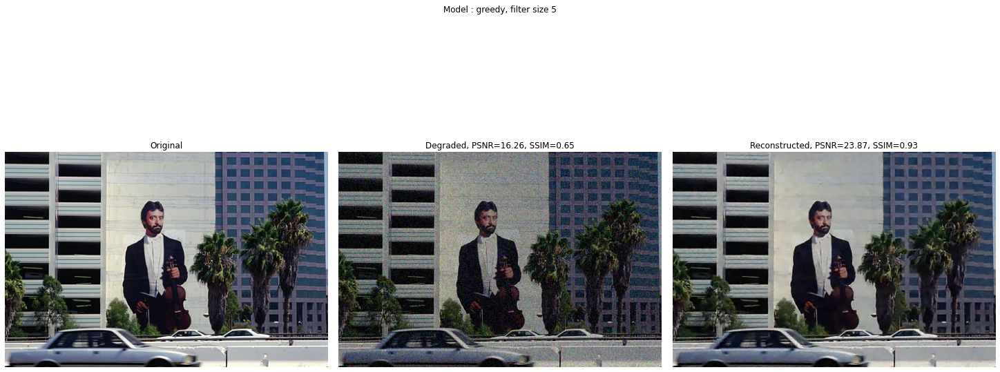

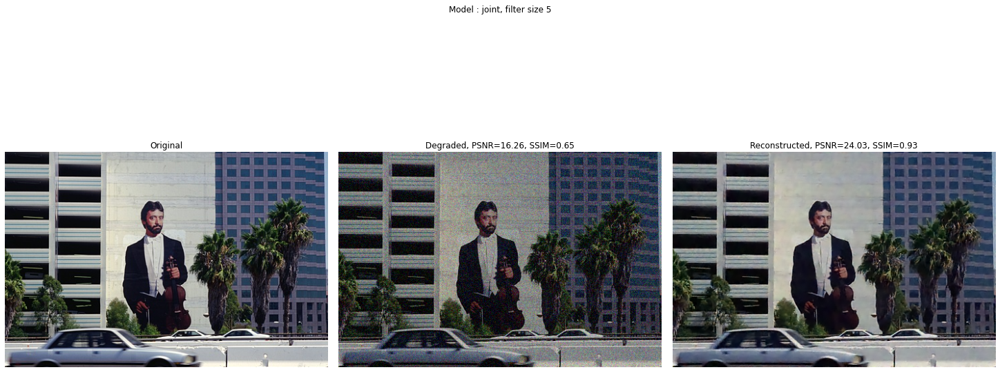

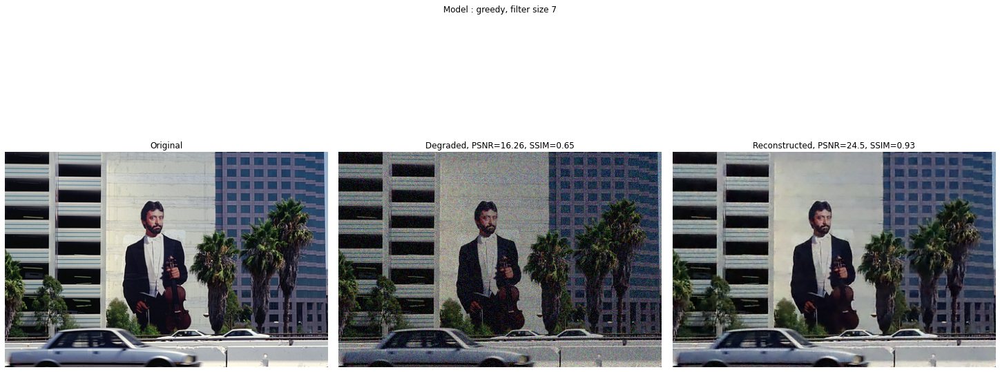

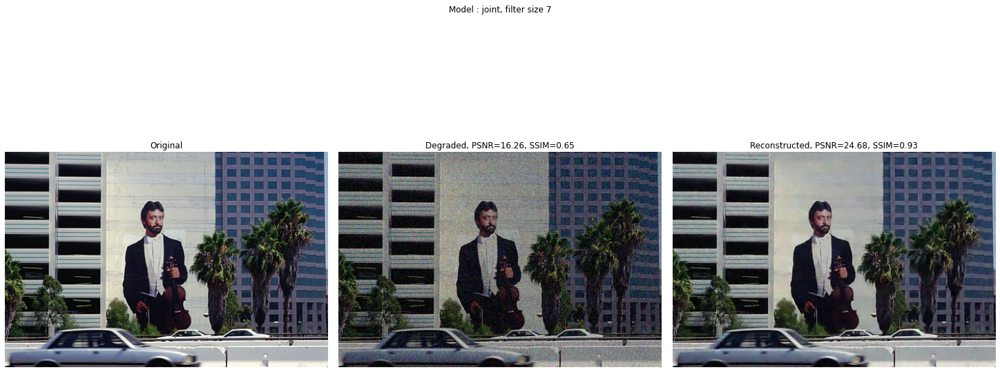

In [23]:
#Initialization
noise_type ='Gaussian'
parameter={'sigma':25}
test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)
im_noisy, im =test_loader.dataset[0]
im_noisy_np=convert_to_numpy(im_noisy)
im_np=convert_to_numpy(im)



#model 1

mode='greedy'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')


mode='joint'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='greedy'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)
fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='joint'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)


fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')

### Ours SnP

Files already downloaded
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])


(-0.5, 480.5, 320.5, -0.5)

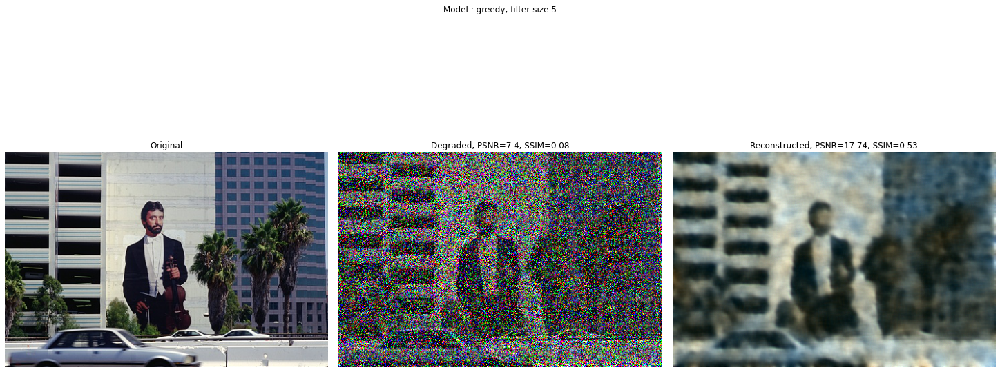

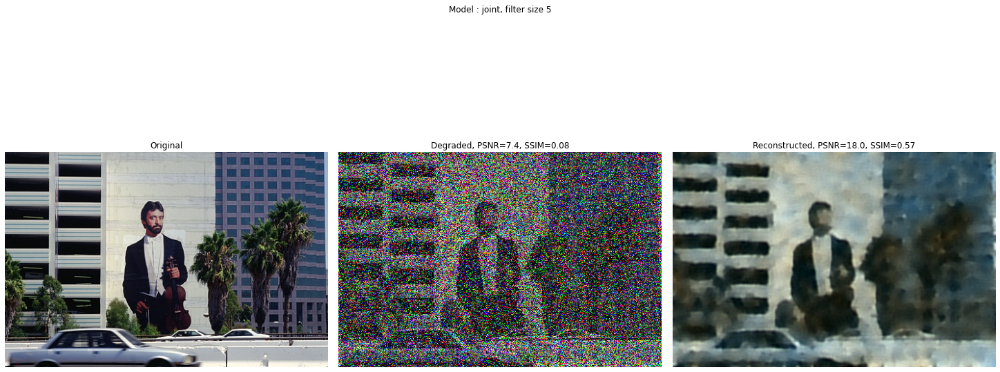

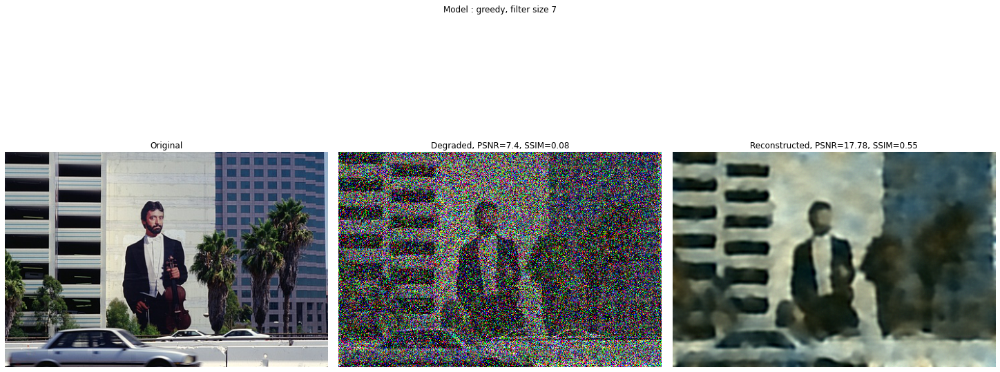

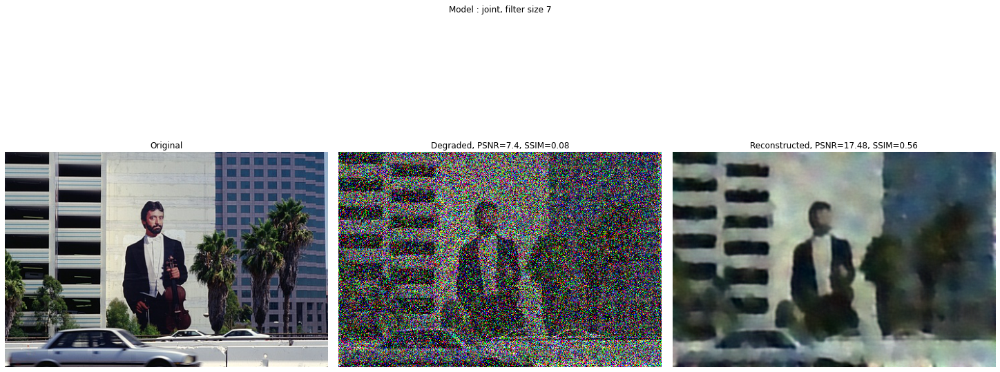

In [24]:
#Initialization
noise_type ='SnP'
parameter={'threshold':0.002}
test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)
im_noisy, im =test_loader.dataset[0]
im_noisy_np=convert_to_numpy(im_noisy)
im_np=convert_to_numpy(im)



#model 1

mode='greedy'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')


mode='joint'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='greedy'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)
fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='joint'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)


fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')


### Skimage S&P

Files already downloaded
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])


(-0.5, 480.5, 320.5, -0.5)

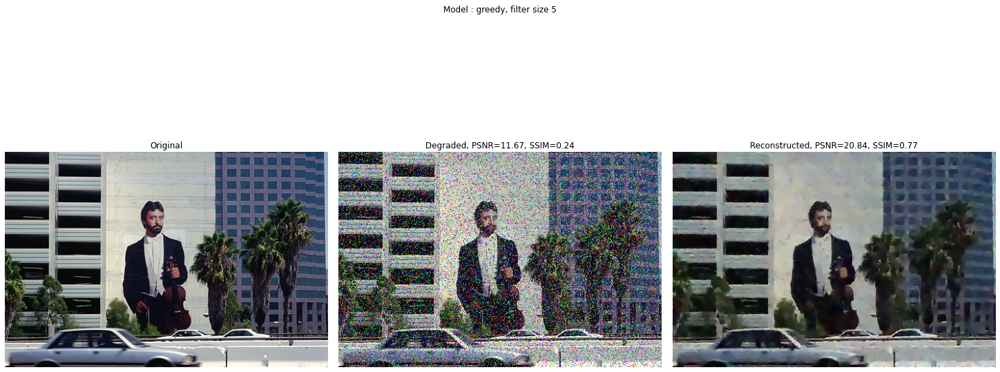

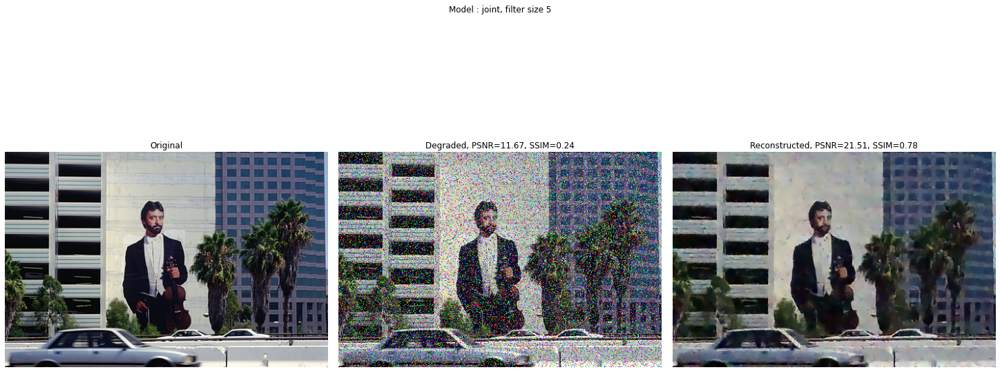

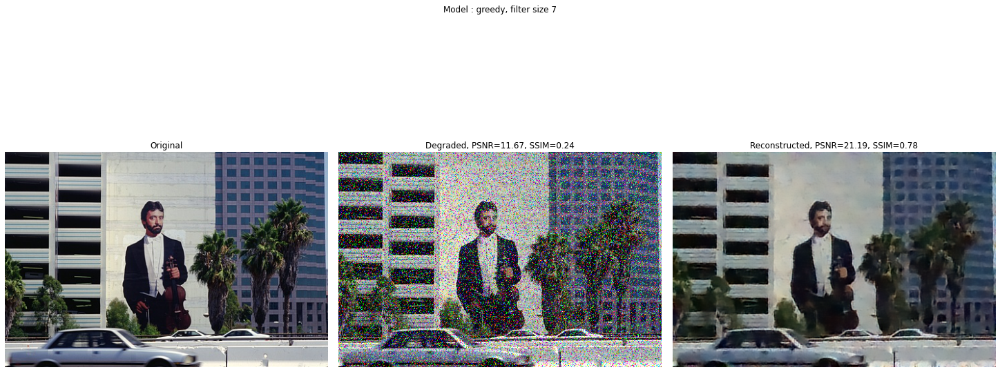

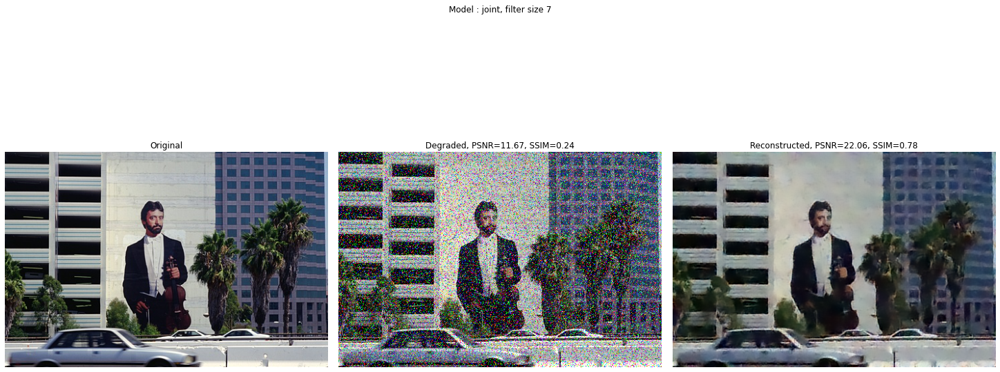

In [25]:
#Initialization
noise_type ='s&p'
parameter={'amount':0.2}
test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)
im_noisy, im =test_loader.dataset[0]
im_noisy_np=convert_to_numpy(im_noisy)
im_np=convert_to_numpy(im)



#model 1

mode='greedy'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')


mode='joint'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='greedy'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)
fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='joint'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)


fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')

### Poisson noise

Files already downloaded
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])


(-0.5, 480.5, 320.5, -0.5)

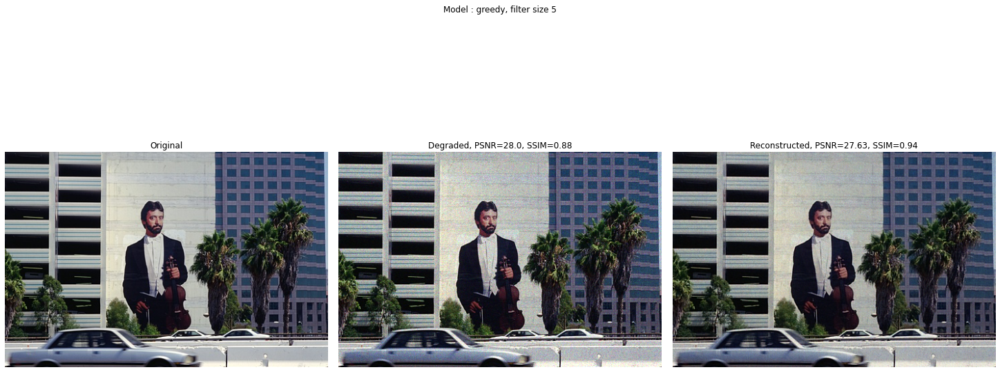

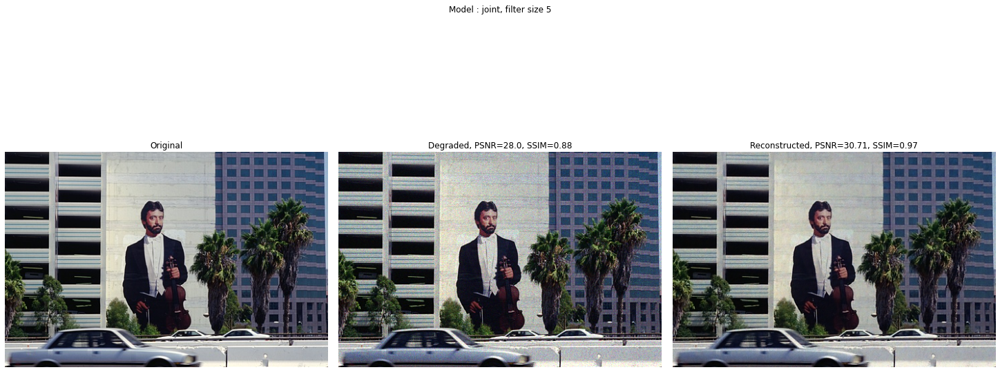

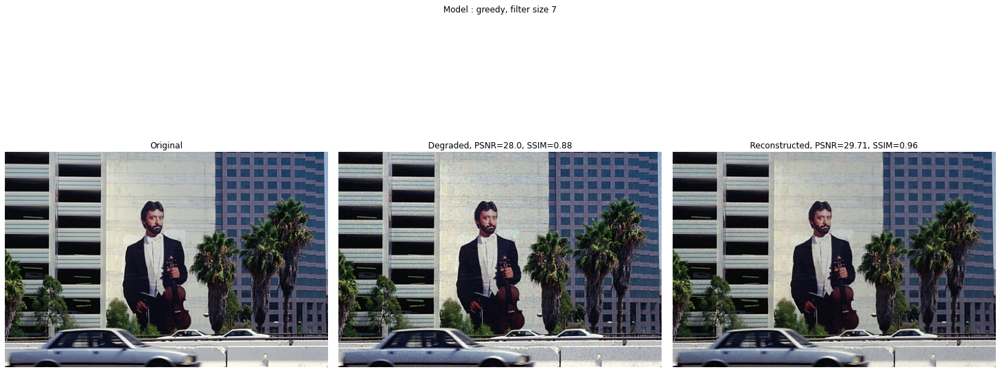

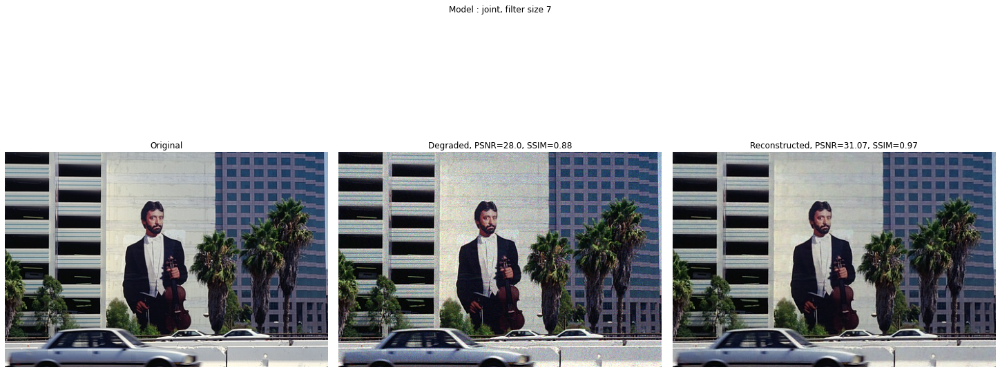

In [26]:
#Initialization
noise_type ='poisson'
parameter={}
test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)
im_noisy, im =test_loader.dataset[0]
im_noisy_np=convert_to_numpy(im_noisy)
im_np=convert_to_numpy(im)



#model 1

mode='greedy'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')


mode='joint'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='greedy'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)
fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='joint'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)


fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')

### Speckle noise

Files already downloaded
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])


(-0.5, 480.5, 320.5, -0.5)

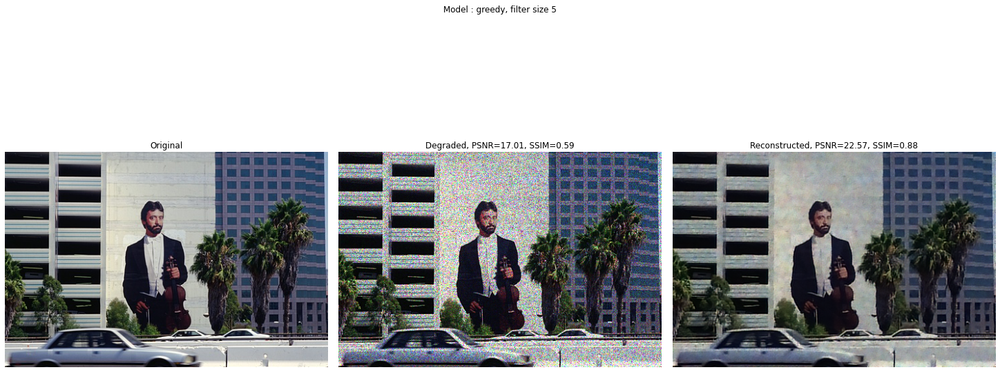

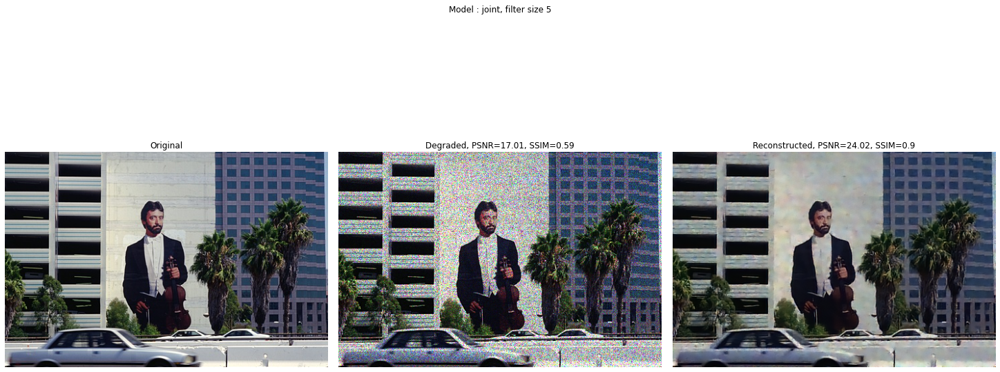

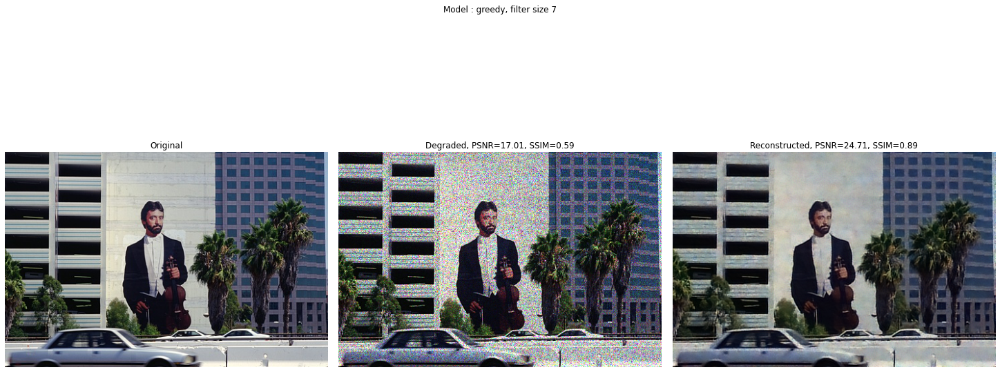

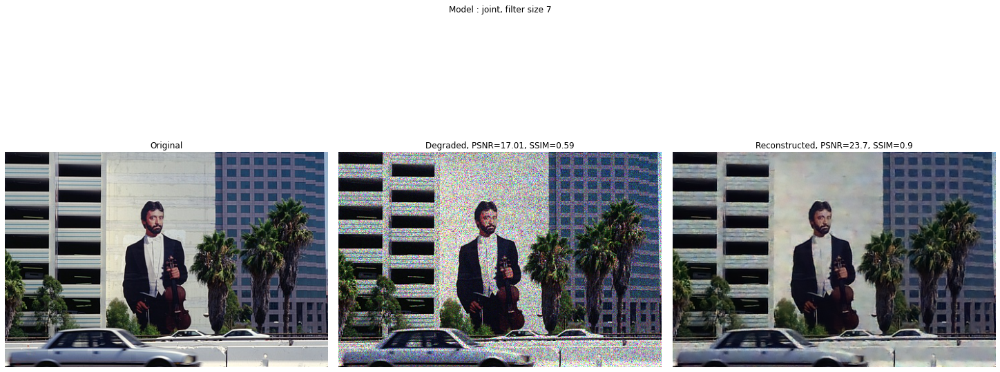

In [27]:
#Initialization
noise_type ='speckle'
parameter={'sigma':25}
test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)
im_noisy, im =test_loader.dataset[0]
im_noisy_np=convert_to_numpy(im_noisy)
im_np=convert_to_numpy(im)



#model 1

mode='greedy'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')


mode='joint'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='greedy'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)
fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='joint'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)


fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')

Files already downloaded
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])
torch.Size([1, 3, 321, 481])


(-0.5, 480.5, 320.5, -0.5)

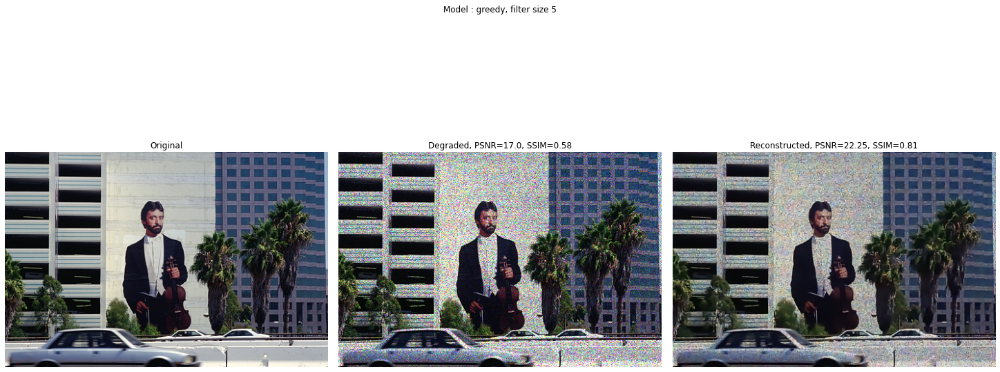

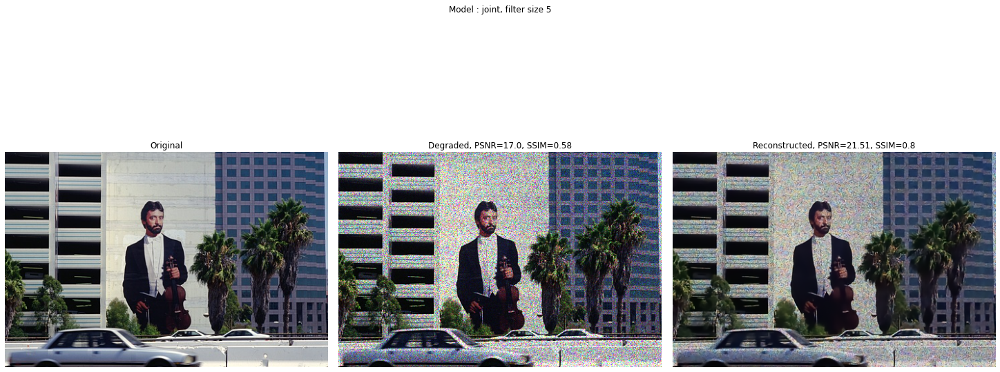

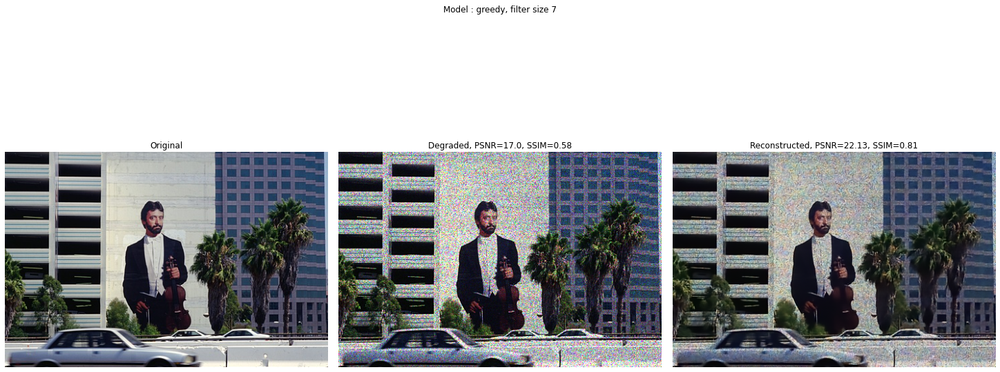

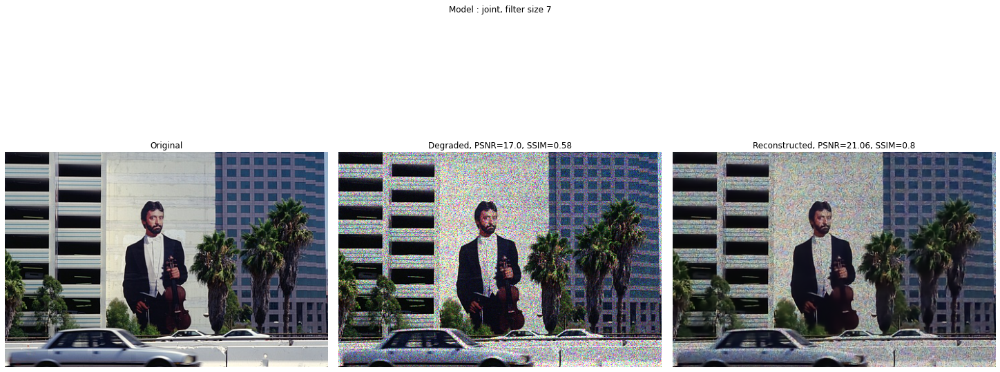

In [30]:
#Initialization
noise_type ='speckle'
parameter={'sigma':25}
test_loader = BerkeleyLoader(noise_type=noise_type, parameter=parameter, train=False, num_workers=2)
im_noisy, im =test_loader.dataset[0]
im_noisy_np=convert_to_numpy(im_noisy)
im_np=convert_to_numpy(im)


noise_type ='Gaussian'
#model 1

mode='greedy'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')


mode='joint'
steps=8
n_filters=24
filter_size=5
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)

fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='greedy'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)
fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')



mode='joint'
steps=8
n_filters=48
filter_size=7
model_path = noise_type+'_'+mode+str(filter_size)+'.pth'
model = DiffusionNet(T=steps, n_rbf=63, n_channels=3, n_filters=n_filters, filter_size=filter_size).cuda()
model.load_state_dict(torch.load(model_path))

im_pred , psnr_steps = predict(model, im_noisy, im)
im_pred_np=convert_to_numpy(im_pred)


fig, axs = plt.subplots(1, 3, constrained_layout=True, figsize=(20,10))
axs[0].imshow(im_np)
axs[0].set_title('Original')
axs[0].axis('off')
fig.suptitle(f'Model : {mode}, filter size {filter_size}')

axs[1].imshow(im_noisy_np)
axs[1].set_title(f'Degraded, PSNR={round(psnr(im_np, im_noisy_np),2)}, SSIM={round(ssim(im_np, im_noisy_np, multichannel=True),2)}')
axs[1].axis('off')

axs[2].imshow(im_pred_np)
axs[2].set_title(f'Reconstructed, PSNR={round(psnr(im_np, im_pred_np),2)}, SSIM={round(ssim(im_np, im_pred_np, multichannel=True),2)}')
axs[2].axis('off')